<a href="https://colab.research.google.com/github/ashok2216-A/bird_species_classification/blob/main/BirdSpecies_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import json
key = {"username":"asxxxxx","key":"71xxxxxxxxxxxxxxxxxxxxxx8ced93"}
with open('kaggle.json', 'w') as f:
    json.dump(key, f)

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d soumendraprasad/sound-of-114-species-of-birds-till-2022

Dataset URL: https://www.kaggle.com/datasets/soumendraprasad/sound-of-114-species-of-birds-till-2022
License(s): CC0-1.0
 99% 2.05G/2.06G [00:25<00:00, 91.1MB/s]
100% 2.06G/2.06G [00:26<00:00, 85.1MB/s]


In [ ]:
%%capture
!unzip /content/sound-of-114-species-of-birds-till-2022.zip

In [ ]:
import os
import glob
import shutil
import zipfile
import matplotlib.pyplot as plt
plt.style.use('dark_background')
import seaborn as sns
import numpy as np
import librosa
from IPython.display import Audio
import pandas as pd
import numpy as np
import os
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix

In [ ]:
meta_data = pd.read_csv('/content/Birds Voice.csv')
meta_data

,common_name,scientific_name,recordist_name,recording_length,Date,TYPE,xc_id,Time,Country,Download_link
0,Common Ostrich,Struthio camelus australis,Frank Lambert,0:53,2019-10-30,call,XC516153,08:05,South Africa,https://xeno-canto.org/516153/download
1,Common Ostrich,Struthio camelus,Jeremy Hegge,0:26,2014-11-20,call,XC208209,04:00,South Africa,https://xeno-canto.org/208209/download
2,Common Ostrich,Struthio camelus,Jeremy Hegge,0:04,2014-11-21,call,XC208128,06:00,South Africa,https://xeno-canto.org/208128/download
3,Common Ostrich,Struthio camelus,Derek Solomon,0:11,2010-02-09,call,XC46725,07:00,South Africa,https://xeno-canto.org/46725/download
4,Common Ostrich,Struthio camelus,Morioka Zoological Park ZOOMO,1:47,2021-09-06,"voice during egg laying, zoo collection",XC675445,17:00,Japan,https://xeno-canto.org/675445/download
...,...,...,...,...,...,...,...,...,...,...
2156,Black-fronted Piping Guan,Pipile jacutinga,Peter Boesman,0:06,2004-08-06,song,XC228155,05:45,Brazil,https://xeno-canto.org/228155/download
2157,Black-fronted Piping Guan,Pipile jacutinga,Robson Silva e Silva,0:02,2012-09-19,wing sounds,XC110142,08:05,Brazil,https://xeno-canto.org/110142/download
2158,Black-fronted Piping Guan,Pipile jacutinga,Robson Silva e Silva,0:04,2012-09-19,song,XC110141,08:05,Brazil,https://xeno-canto.org/110141/download
2159,Black-fronted Piping Guan,Pipile jacutinga,Jeremy Minns,0:05,2003-10-08,wing sounds while displaying,XC85349,06:44,Brazil,https://xeno-canto.org/85349/download


In [ ]:
def audio_waveframe(file_path):
    # Load the audio file
    audio_data, sampling_rate = librosa.load(file_path)
    # Calculate the duration of the audio file
    duration = len(audio_data) / sampling_rate
    # Create a time array for plotting
    time = np.arange(0, duration, 1/sampling_rate)
    # Plot the waveform
    plt.figure(figsize=(30, 4))
    plt.plot(time, audio_data, color='blue')
    plt.title('Audio Waveform')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plot = plt.show()
    return plot

def spectrogram(file_path):
    # Compute the short-time Fourier transform (STFT)
    n_fft = 500  # Number of FFT points 2048
    hop_length = 50  # Hop length for STFT 512
    audio_data, sampling_rate = librosa.load(file_path)
    stft = librosa.stft(audio_data, n_fft=n_fft, hop_length=hop_length)
    # Convert the magnitude spectrogram to decibels (log scale)
    spectrogram = librosa.amplitude_to_db(np.abs(stft))
    # Plot the spectrogram
    plt.figure(figsize=(30, 6))
    librosa.display.specshow(spectrogram, sr=sampling_rate, hop_length=hop_length, x_axis='time', y_axis='linear')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Spectrogram')
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    plt.tight_layout()
    plot = plt.show()
    return plot

def audio_analysis(file_path):
    aw = audio_waveframe(file_path)
    spg = spectrogram(file_path)
    return aw, spg

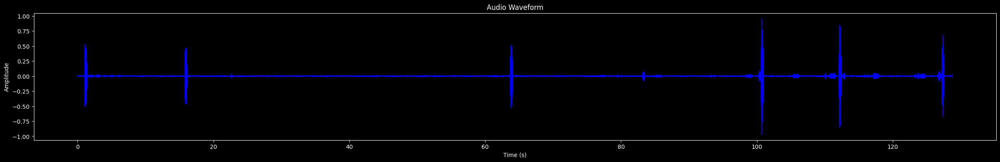

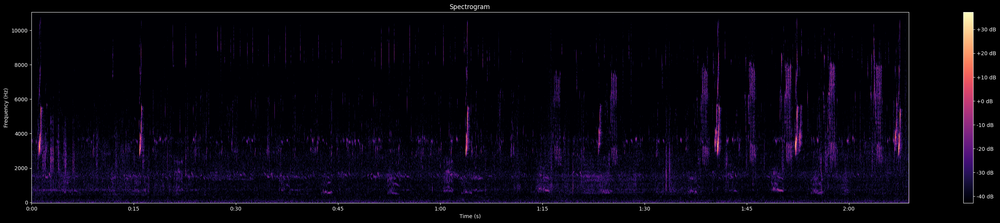

In [ ]:
audio_analysis('/content/Voice of Birds/Voice of Birds/Andean Tinamou_sound/Andean Tinamou10.mp3')
Audio('/content/Voice of Birds/Voice of Birds/Andean Tinamou_sound/Andean Tinamou10.mp3')

In [ ]:
!pip install tqdm
import os
import librosa
import numpy as np
import soundfile as sf
import random
from tqdm import tqdm

# Define augmentation functions
def add_noise(data, noise_factor=0.005):
    noise = np.random.randn(len(data))
    augmented_data = data + noise_factor * noise
    augmented_data = augmented_data.astype(type(data[0]))
    return augmented_data

def time_stretch(data, rate=1.0):
    return librosa.effects.time_stretch(data, rate=rate)

def pitch_shift(data, sr, n_steps=2):
    return librosa.effects.pitch_shift(y=data, sr=sr, n_steps=n_steps)

def shift(data, shift_max=0.2):
    shift = np.random.randint(len(data) * shift_max)
    if shift > 0:
        return np.roll(data, shift)
    else:
        return np.roll(data, -shift)

def augment_and_save(audio_path, output_dir, augmentations):
    y, sr = librosa.load(audio_path)
    base_name = os.path.splitext(os.path.basename(audio_path))[0]

    for i, aug in enumerate(augmentations):
        augmented_data = aug(y, sr)
        output_file = f"{base_name}_aug_{i+1}.wav"
        sf.write(os.path.join(output_dir, output_file), augmented_data, sr)

# Define main function with tqdm progress bar
def augment_bird_audio(base_dir, augmentations):
    # Count total audio files for tqdm
    total_files = sum([len(os.listdir(os.path.join(base_dir, bird_dir)))
                        for bird_dir in os.listdir(base_dir)
                        if os.path.isdir(os.path.join(base_dir, bird_dir))])

    with tqdm(total=total_files, desc="Augmenting audio files") as pbar:
        for bird_dir in os.listdir(base_dir):
            bird_path = os.path.join(base_dir, bird_dir)
            if os.path.isdir(bird_path):
                for audio_file in os.listdir(bird_path):
                    if audio_file.endswith('.mp3'):
                        audio_path = os.path.join(bird_path, audio_file)
                        augment_and_save(audio_path, bird_path, augmentations)
                        pbar.update(1)  # Update progress bar after each file

# List of augmentation techniques to apply
augmentations = [
    lambda y, sr: add_noise(y),
    lambda y, sr: time_stretch(y, rate=random.uniform(0.8, 1.2)),
    lambda y, sr: pitch_shift(y, sr, n_steps=random.randint(-2, 2)),
    lambda y, sr: shift(y)
]

# Path to the base directory containing bird directories
base_dir = "/content/Voice_of_Birds/Voice_of_Birds"

# Run augmentation with progress bar
augment_bird_audio(base_dir, augmentations)

In [ ]:
# Path to the directory containing your audio dataset
dataset_dir = '/content/Voice_of_Birds/Voice_of_Birds'
# Initialize an empty dictionary to store the mapping between audio files and labels
label_mapping = {}
# Iterate over subdirectories (classes) in the dataset directory
for label in os.listdir(dataset_dir):
    label_dir = os.path.join(dataset_dir, label)
    # Check if the item in the dataset directory is a directory
    if os.path.isdir(label_dir):
        # Iterate over audio files in the subdirectory (class)
        for audio_file in os.listdir(label_dir):
            # Add the mapping between audio file path and label to the dictionary
            audio_file_path = os.path.join(label_dir, audio_file)
            label_mapping[audio_file_path] = label

In [ ]:
# Create a list of tuples containing the audio file paths and labels
data = [(audio_file_path, label) for audio_file_path, label in label_mapping.items()]
# Create a Pandas DataFrame from the list of tuples
annotated_data = pd.DataFrame(data, columns=['audio_file_path', 'label'])
annotated_data

,audio_file_path,label
0,/content/Voice_of_Birds/Voice_of_Birds/Small-b...,Small-billed Tinamou_sound
1,/content/Voice_of_Birds/Voice_of_Birds/Small-b...,Small-billed Tinamou_sound
2,/content/Voice_of_Birds/Voice_of_Birds/Small-b...,Small-billed Tinamou_sound
3,/content/Voice_of_Birds/Voice_of_Birds/Small-b...,Small-billed Tinamou_sound
4,/content/Voice_of_Birds/Voice_of_Birds/Small-b...,Small-billed Tinamou_sound
...,...,...
2194,/content/Voice_of_Birds/Voice_of_Birds/Quebrac...,Quebracho Crested Tinamou_sound
2195,/content/Voice_of_Birds/Voice_of_Birds/Quebrac...,Quebracho Crested Tinamou_sound
2196,/content/Voice_of_Birds/Voice_of_Birds/Quebrac...,Quebracho Crested Tinamou_sound
2197,/content/Voice_of_Birds/Voice_of_Birds/Quebrac...,Quebracho Crested Tinamou_sound


In [ ]:
# Function to extract features from audio file
def extract_features(file_path):
    # Load audio file
    audio, sample_rate = librosa.load(file_path)
    # Extract features using Mel-Frequency Cepstral Coefficients (MFCC)
    mfccs = librosa.feature.mfcc(y=audio, sr=sample_rate, n_mfcc=40)
    # Flatten the features into a 1D array
    flattened_features = np.mean(mfccs.T, axis=0)
    return flattened_features

# Function to load dataset and extract features
def load_data_and_extract_features(data_dir):
    labels = []
    features = []
    # Loop through each audio file in the dataset directory
    for filename in os.listdir(data_dir):
        if filename.endswith('.wav'):
            file_path = os.path.join(data_dir, filename)
            # Extract label from filename
            label = filename.split('-')[0]
            labels.append(label)
            # Extract features from audio file
            feature = extract_features(file_path)
            features.append(feature)
    return np.array(features), np.array(labels)

In [ ]:
extracted_features = []

for i in tqdm(annotated_data['audio_file_path']):
    features = extract_features(file_path=i)
    # print(features)
    extracted_features.append(features)

 29%|██▉       | 3132/10805 [08:03<17:53,  7.15it/s]<ipython-input-32-51956c2fc2d5>:4: UserWarning: PySoundFile failed. Trying audioread instead.
  audio, sample_rate = librosa.load(file_path)
/usr/local/lib/python3.10/dist-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)
 43%|████▎     | 4646/10805 [11:51<09:56, 10.33it/s]<ipython-input-32-51956c2fc2d5>:4: UserWarning: PySoundFile failed. Trying audioread instead.
  audio, sample_rate = librosa.load(file_path)
/usr/local/lib/python3.10/dist-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)
 48%|████▊     | 5195/10805 [13:14<12:30,  7.47it/s]<ipython-input-32-51956c

In [ ]:
import numpy as np

np.save('extracted_features.npy', extracted_features)

In [ ]:
extracted_features = np.load('/content/extracted_features.npy')

In [ ]:
label_encoder = LabelEncoder()
annotated_data['encoded_label'] = label_encoder.fit_transform(annotated_data['label'])
annotated_data

,audio_file_path,label,encoded_label
0,/content/Voice_of_Birds/Voice_of_Birds/Small-b...,Small-billed Tinamou_sound,85
1,/content/Voice_of_Birds/Voice_of_Birds/Small-b...,Small-billed Tinamou_sound,85
2,/content/Voice_of_Birds/Voice_of_Birds/Small-b...,Small-billed Tinamou_sound,85
3,/content/Voice_of_Birds/Voice_of_Birds/Small-b...,Small-billed Tinamou_sound,85
4,/content/Voice_of_Birds/Voice_of_Birds/Small-b...,Small-billed Tinamou_sound,85
...,...,...,...
2194,/content/Voice_of_Birds/Voice_of_Birds/Quebrac...,Quebracho Crested Tinamou_sound,72
2195,/content/Voice_of_Birds/Voice_of_Birds/Quebrac...,Quebracho Crested Tinamou_sound,72
2196,/content/Voice_of_Birds/Voice_of_Birds/Quebrac...,Quebracho Crested Tinamou_sound,72
2197,/content/Voice_of_Birds/Voice_of_Birds/Quebrac...,Quebracho Crested Tinamou_sound,72


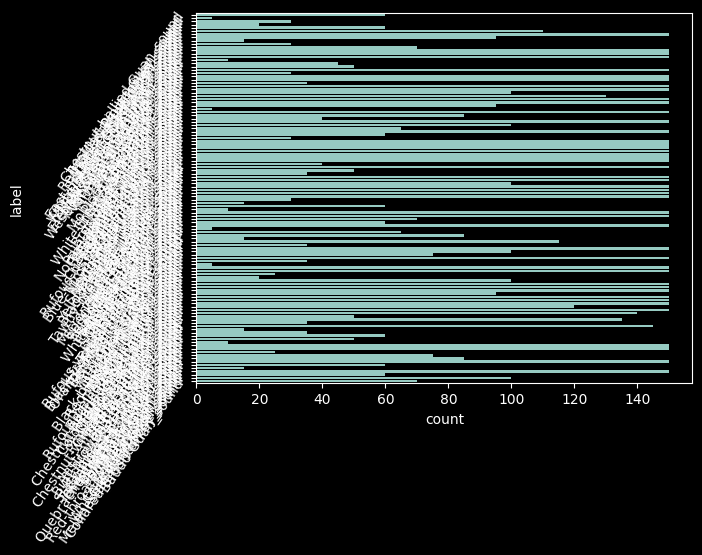

In [ ]:
sns.countplot(annotated_data['label'])
plt.yticks(rotation=55)
plt.show()

In [ ]:
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import RandomOverSampler

In [ ]:
# x = np.vstack(extracted_features)
x = np.array(extracted_features)
y = annotated_data['encoded_label']
ros = RandomOverSampler(random_state=42)
features_resampled, labels_reshampled = ros.fit_resample(x, y)
# # Normalize features
# scaler = StandardScaler()
# X_normalized = scaler.fit_transform(features_resampled)
x = features_resampled.reshape(features_resampled.shape[0], 1, features_resampled.shape[1])
# x = features_resampled
y = labels_reshampled
x.shape

(16358, 1, 40)

In [ ]:
import tensorflow
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.optimizers import Adam
# 4. Split data
X_train, X_test, y_train, y_test = train_test_split(
    x, y, test_size=0.2, random_state=42
)

# Model Building
model = Sequential()
model.add(LSTM(256, input_shape=(X_train.shape[1], X_train.shape[2]), return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(128))
model.add(Dropout(0.2))
model.add(Dense(len(np.unique(y)), activation='softmax'))

# Model Training
model.compile(loss='sparse_categorical_crossentropy', optimizer=Adam(learning_rate=0.001), metrics=['accuracy'])
history = model.fit(X_train, y_train, epochs=50, batch_size=16, validation_data=(X_test, y_test))

# --- Evaluation ---
loss, accuracy = model.evaluate(X_test, y_test)
print("Accuracy:", accuracy)

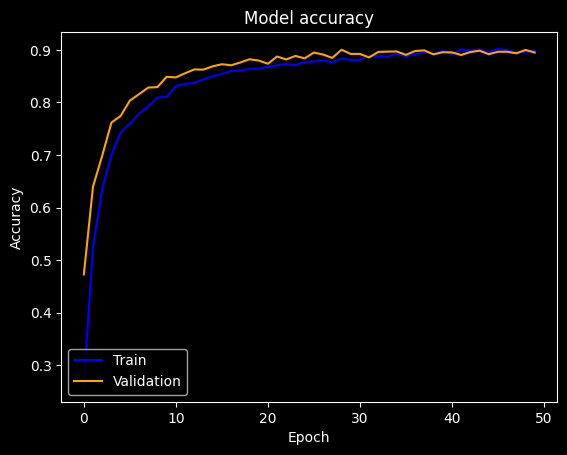

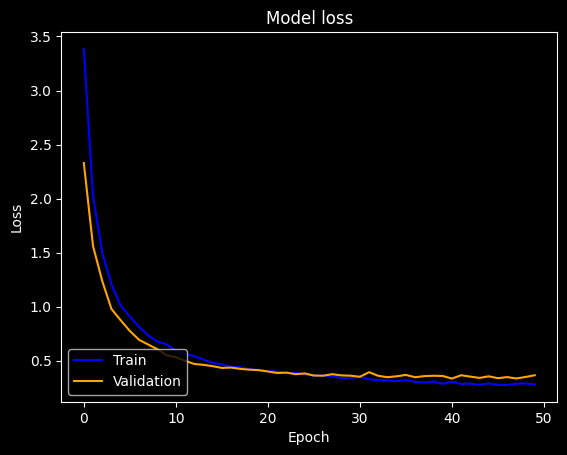

In [ ]:
import matplotlib.pyplot as plt

# Assuming 'history' is the output of model.fit()
# history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))

# Plot training & validation accuracy values
plt.plot(history.history['accuracy'],color='blue')
plt.plot(history.history['val_accuracy'], color='orange')
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='lower left')
plt.show()

# Plot training & validation loss values
plt.plot(history.history['loss'], color='blue')
plt.plot(history.history['val_loss'], color='orange')
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='lower left')
plt.show()

In [ ]:
import zipfile

with zipfile.ZipFile('Voice_of_Birds.zip', 'w') as zip_obj:
  # Iterate over all files in the directory
  for foldername, subfolders, filenames in os.walk('/content/Voice_of_Birds'):
    for filename in filenames:
      # Create the full file path
      file_path = os.path.join(foldername, filename)
      # Add file to zip
      zip_obj.write(file_path)

In [ ]:
def predict_audio_class(audio_file_path):
    features = extract_features(audio_file_path)
    features = features.reshape(1, 1, features.shape[0])
    prediction = model.predict(features)
    predicted_class_index = np.argmax(prediction)
    predicted_class_label = label_encoder.inverse_transform([predicted_class_index])[0]
    return predicted_class_label

In [ ]:
predict_audio_class('/content/351477.mp3')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


'Brown Tinamou_sound'

In [ ]:
# ... (Your existing model training code) ...

# Save the entire model
model.save('bird_audio_classification_model.h5')

In [ ]:
from tensorflow.keras.layers import GRU, Dense, Dropout
# Build the GRU model
model = Sequential()
model.add(GRU(128, input_shape=(X_train.shape[1], X_train.shape[2]), return_sequences=True))
model.add(Dropout(0.4))
model.add(GRU(64))
model.add(Dropout(0.4))
model.add(Dense(len(np.unique(y)), activation='softmax'))

# Compile the model
model.compile(loss='sparse_categorical_crossentropy', optimizer=Adam(learning_rate=0.001), metrics=['accuracy'])

# Train the model
model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))

# Evaluate the model
loss, accuracy = model.evaluate(X_test, y_test)
print("Accuracy:", accuracy)

Epoch 1/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - accuracy: 0.0126 - loss: 4.7301 - val_accuracy: 0.0901 - val_loss: 4.6583
Epoch 2/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.0689 - loss: 4.6218 - val_accuracy: 0.1270 - val_loss: 4.5449
Epoch 3/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.1173 - loss: 4.4768 - val_accuracy: 0.1594 - val_loss: 4.3741
Epoch 4/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.1485 - loss: 4.2762 - val_accuracy: 0.1778 - val_loss: 4.1598
Epoch 5/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.1684 - loss: 4.0711 - val_accuracy: 0.2333 - val_loss: 3.9493
Epoch 6/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.1858 - loss: 3.8393 - val_accuracy: 0.2587 - val_loss: 3.7508
Epoch 7/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.2358 - loss: 3.6708 - val_accuracy: 0.2864 - val_loss: 3.5560
Epoch 8/100
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.2581 - loss: 3.4575 - val_accuracy: 0.3233 - 

107/107 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step


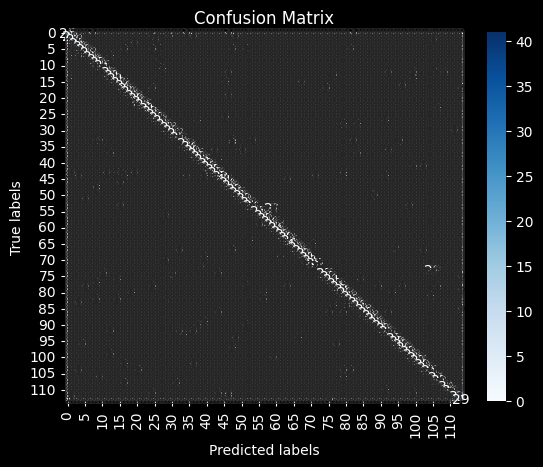

In [ ]:
# ... (Your existing model training code) ...

# Predict labels for the test set
y_predict = model.predict(X_test)
y_predict = np.argmax(y_predict, axis=1)  # Convert predicted probabilities to class labels

confusion_matrix = confusion_matrix(y_test, y_predict)
# Plot the confusion matrix
sns.heatmap(confusion_matrix, cmap=plt.cm.Blues, annot=True)
plt.xlabel("Predicted labels")
plt.ylabel("True labels")
plt.title("Confusion Matrix")
plt.show()

In [ ]:
def audio_classificcation(file_path):
    audio = file_path
    print(audio)
    extracted_features = extract_features(audio).reshape(1, -1)
    # extracted_features = x_test[112].reshape(1, -1)
    y_predict = model.predict(extracted_features)
    labels_list = annotated_data['label'].unique()
    encoded_label = annotated_data['encoded_label'].unique()

    labels = {}
    for label, prediction in zip(encoded_label, labels_list):
        labels[label] = prediction
    if y_predict[0] in labels.keys():
        predicted = ('Predicted Class:', labels[y_predict[0]])
    return predicted

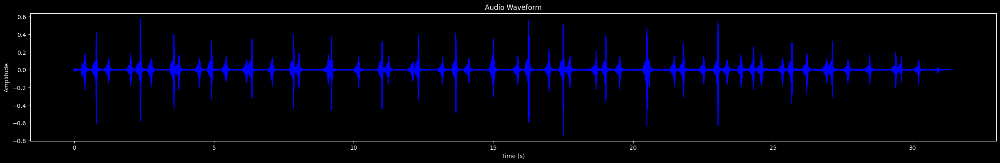

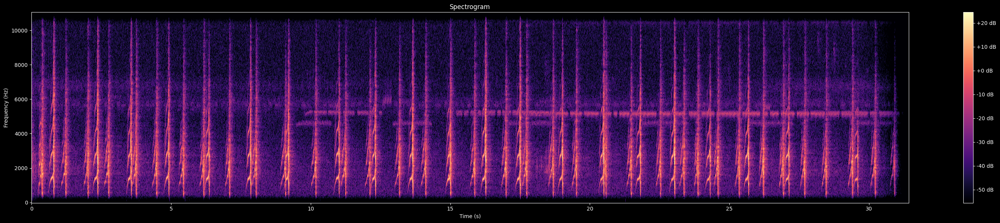

In [ ]:
file_path = '/content/Voice of Birds/Voice of Birds/Andean Tinamou_sound/Andean Tinamou24.mp3'
audio_analysis(file_path)
Audio(file_path)

In [ ]:
def predict_audio_class(audio_file_path):
    features = extract_features(audio_file_path)
    features = features.reshape(1, 1, features.shape[0])
    prediction = model.predict(features)
    predicted_class_index = np.argmax(prediction)
    predicted_class_label = label_encoder.inverse_transform([predicted_class_index])[0]
    return predicted_class_label

In [ ]:
predict_audio_class(file_path)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


'Brown Tinamou_sound'

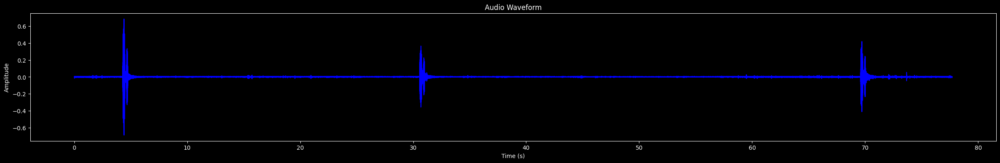

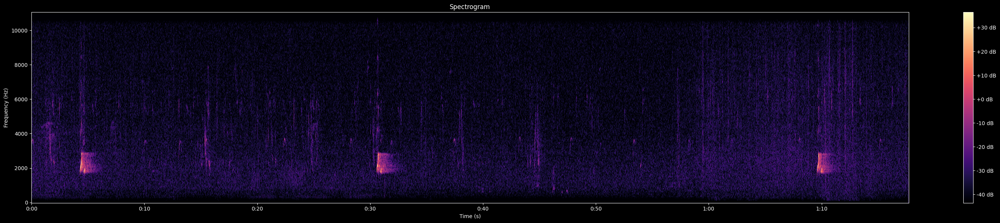

In [ ]:
audio_analysis('/content/335773_HK7QPNc.mp3')
Audio('/content/335773_HK7QPNc.mp3')

In [ ]:
import numpy as np
import librosa
import librosa.display
import scipy.signal
import soundfile as sf # Import soundfile to handle saving audio

def remove_noise(audio_path, noise_profile_duration=2500.0):
    # Load the audio file
    y, sr = librosa.load(audio_path, sr=None)

    # Assume the first `noise_profile_duration` seconds are just noise
    noise_profile = y[:int(sr * noise_profile_duration)]

    # Compute the spectrogram
    S_full, phase = librosa.magphase(librosa.stft(y))

    # Estimate the noise power from the noise profile
    S_noise, _ = librosa.magphase(librosa.stft(noise_profile))

    # Get the mean noise spectrum
    S_noise_mean = np.mean(S_noise, axis=1)

    # Perform spectral gating
    S_denoised = np.maximum(S_full - S_noise_mean[:, np.newaxis], 0)

    # Reconstruct the signal from the denoised spectrogram
    y_denoised = librosa.istft(S_denoised * phase)

    return y_denoised, sr

# Example usage
audio_path = '/content/Voice of Birds/Voice of Birds/Curve-billed Tinamou_sound/Curve-billed Tinamou2.mp3'
y_denoised, sr = remove_noise(audio_path)

# Save the denoised audio using soundfile
sf.write('denoised_audio.wav', y_denoised, sr) # Use soundfile.write to save the audio

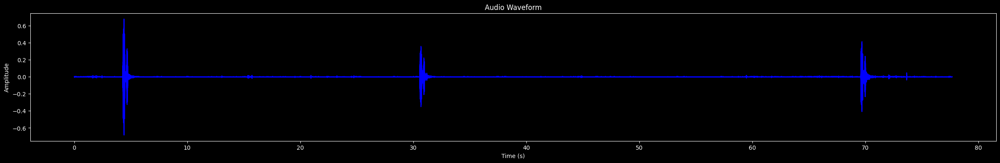

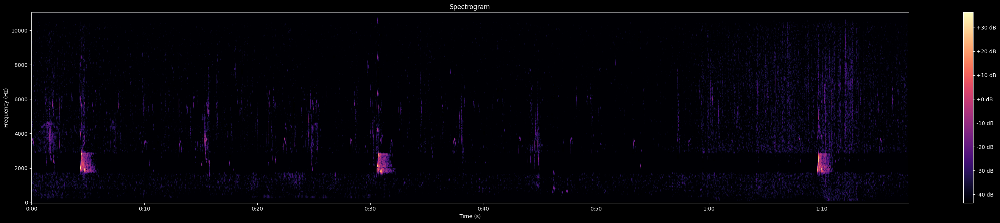

In [ ]:
audio_analysis('/content/denoised_audio.wav')
Audio('/content/denoised_audio.wav')